## Fashion Analysis by Geo-region, Using Valence Features and Inception Features
This notebook looks at the ability of the valence feature space to provide image recommendations in different geographic regions. We repeat this analysis using both valence features and Inception features. For the analyses below, we create a dataset from collections of images that have been manually curated. These collections were found by searching for collections labeled "fashion", "mode" (fashion in French), and "ファッション" (Japanese). This gives us collections of the same topic, but were curated by people of different primary tongues. Then, we choose a collection to be a query collection, using the rest of the images as the corpus. For a number of query collections, we first show the Precision-Recall curves where a postive example is an image from a collection of the same language. Next, we show some example images from the query collection. Finally, we show the top ranked images from the corpus. Among other findings, these results suggest that geo-region is not a strong predictor of image style similarity or user image preference. Additionally, these results suggest that the valence and the Inception feature sets are complementary. Each feature set can identify some user-preferred or similar images that the other cannot.

In [3]:
%matplotlib inline
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid
import numpy as np
import os.path
import pandas as pd
from PIL import Image
import sklearn
import sklearn.metrics
import sklearn.preprocessing
import scipy.spatial
import scipy.stats

In [4]:
def prep_data(data):
    idx = pd.MultiIndex.from_tuples(
        [(x.partition('/')[0], x.split('/')[1], '/'.join(x.split('/')[1:3]), x.rpartition('/')[2]) 
         for x in data.columns], 
        names=['category', 'user', 'group', 'image'])
    
    data = data.T.set_index(idx).sort_index()
    return data

In [5]:
def plot_prcurve_for_group(features, group, rank_func):
    query_group = features.xs(group, level='group', drop_level=False)
    corpus = features.loc[(slice(None), features.index.get_level_values('group') != group, slice(None)), :]
    target_category = corpus.xs(query_group.index[0][0], level='category', drop_level=False)
    
    dists = pd.DataFrame(scipy.spatial.distance.cdist(corpus, query_group), index=corpus.index,
                         columns=query_group.index)
    
    full_rank = rank_func(dists, axis=1)
    query_rank = -dists.min(axis=0)
    
    # Remove duplicate images
    rank = full_rank.groupby(level='image').first()
    rank = rank.sort_index()
    
    pos_images = set(target_category.index.get_level_values('image'))
    labels = pd.Series(np.zeros(rank.shape[0]), index=rank.index.get_level_values('image'))
    labels[pos_images] = 1
    
    
    precision, recall, thresh = sklearn.metrics.precision_recall_curve(
        labels, rank)
    plt.figure(1)
    plt.plot(recall, precision)
    plt.ylim([0.0, 1.0])
    plt.show()
    
    return full_rank, query_rank[query_rank < 0]

In [6]:
def min_dist_rank_func(dists, axis=1):
    return -dists.min(axis=axis)
def mean_dist_rank_func(dists, axis=1):
    return -dists.mean(axis=axis)

In [7]:
def show_images(scores, base_dir='/data/neon/customer_images/image_collections/'):
    '''Show top images from descending scores. The index will get me to the filename'''
    scores = scores.sort_values(ascending=False)
    
    fig = plt.figure(2, (20,16))
    grid = ImageGrid(fig, 111, nrows_ncols=(4, 5))
    i = 0
    for row in scores.index.tolist():
        im = Image.open(os.path.join(base_dir, row[0], row[2], row[3]))
        im.thumbnail((200, 200))
        grid[i].imshow(im)
        grid[i].set_xlim(0., 200.)
        grid[i].set_ylim(200., 0.)
        grid[i].axes.get_xaxis().set_ticks([])
        grid[i].axes.get_yaxis().set_ticks([])
        i += 1
        if i >= 20:
            break
    plt.show()

In [19]:
fashion_features = pd.read_pickle('/data/neon/customer_images/image_collections/intl_fashion/intl_fashion_valence.pkl')
fashion_features = prep_data(fashion_features)

## Valence Examples
Here's some examples of Japanese query collections where the query is done using valence space. The first group of images are those from the query collection that caused the matches. The second group are the top ranked images in the result set.

Note that valence is picking up similarities in natural imagery and image style.

ellegirl_jp/fashion-news-%E3%83%95%E3%82%A1%E3%83%83%E3%82%B7%E3%83%A7%E3%83%B3%E3%83%8B%E3%83%A5%E3%83%BC%E3%82%B9


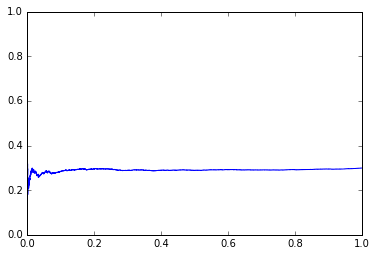

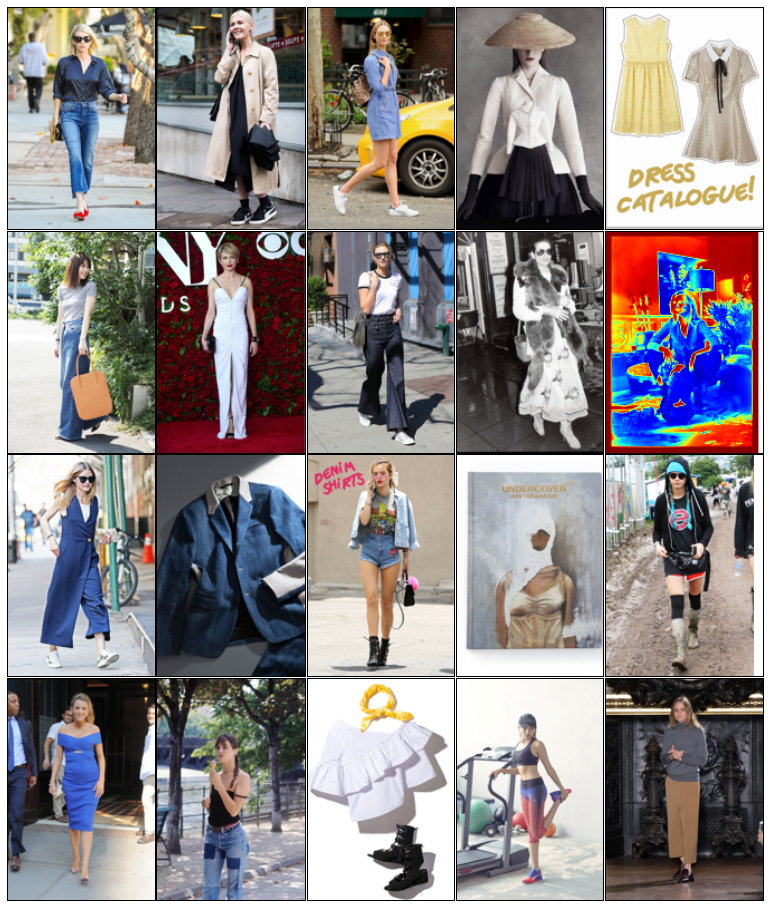

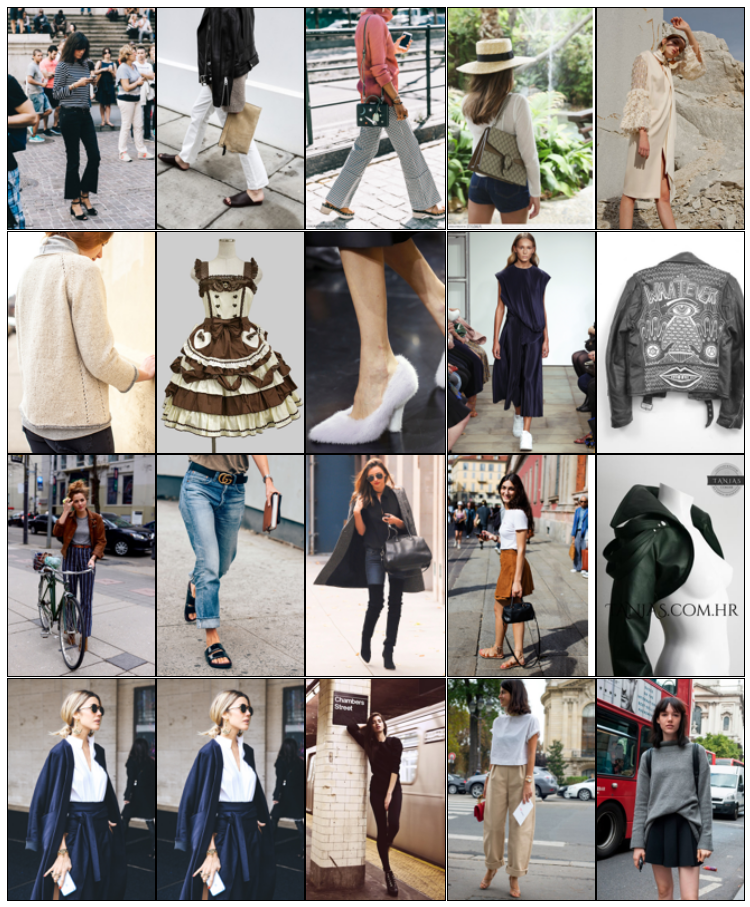

yusuke0101/%E3%83%95%E3%82%A1%E3%83%83%E3%82%B7%E3%83%A7%E3%83%B3


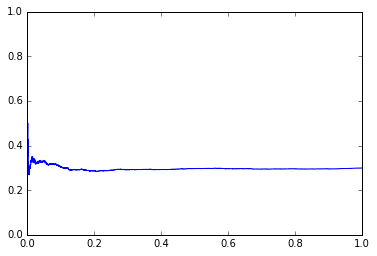

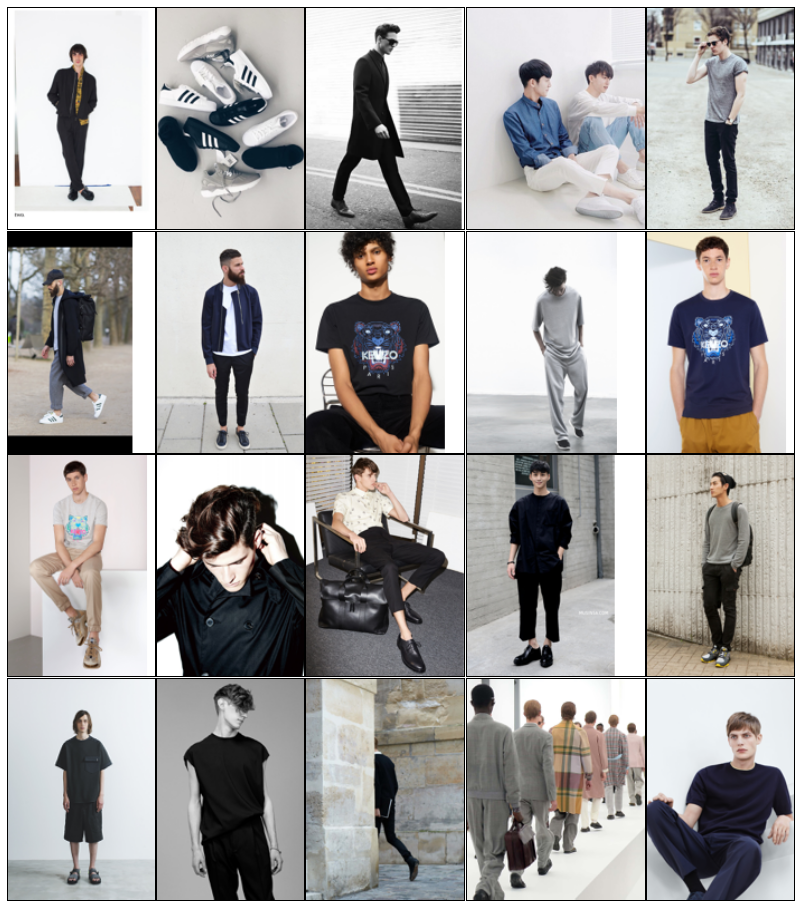

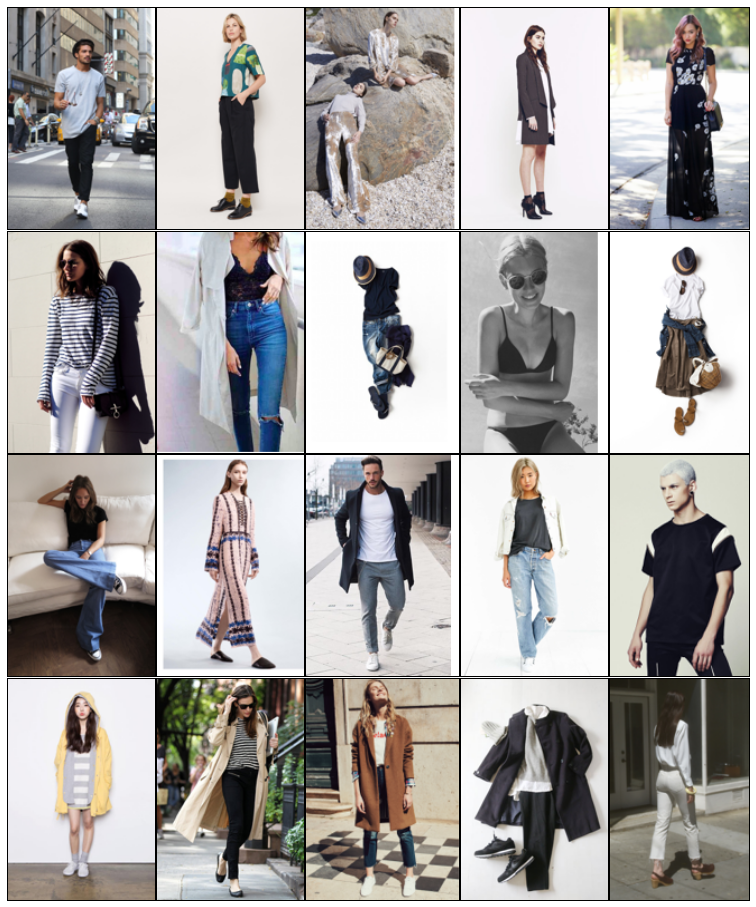

retreatsakura/%E3%83%95%E3%82%A1%E3%83%83%E3%82%B7%E3%83%A7%E3%83%B3


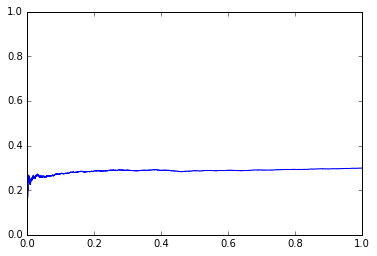

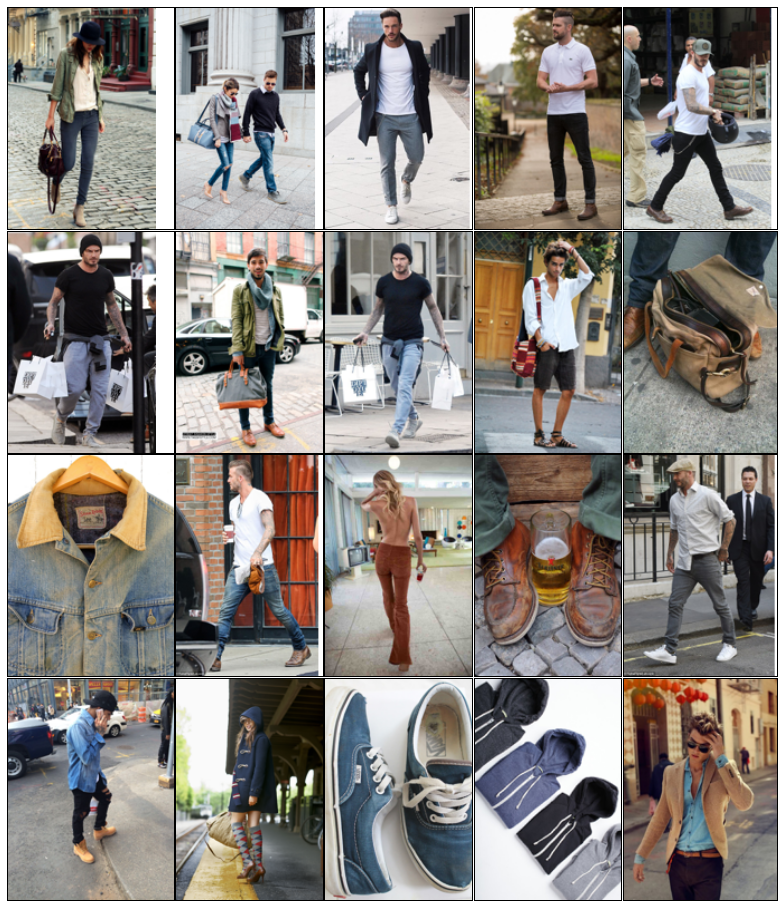

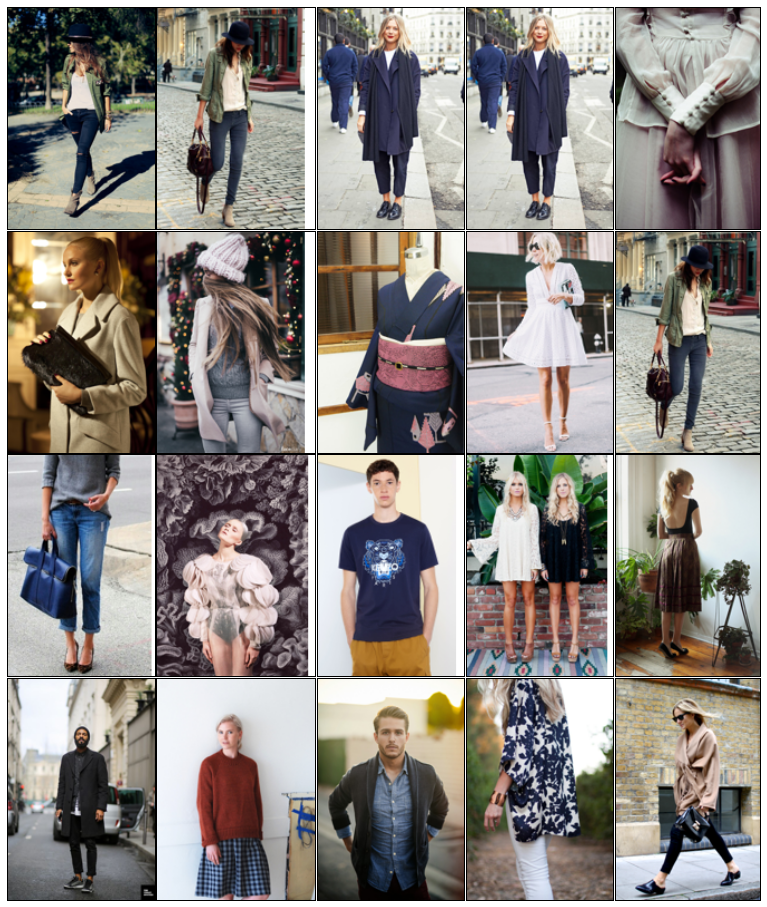

KUNOMARI517/%E3%83%95%E3%82%A1%E3%83%83%E3%82%B7%E3%83%A7%E3%83%B3


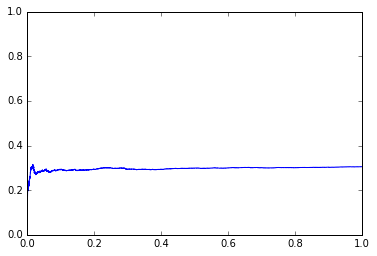

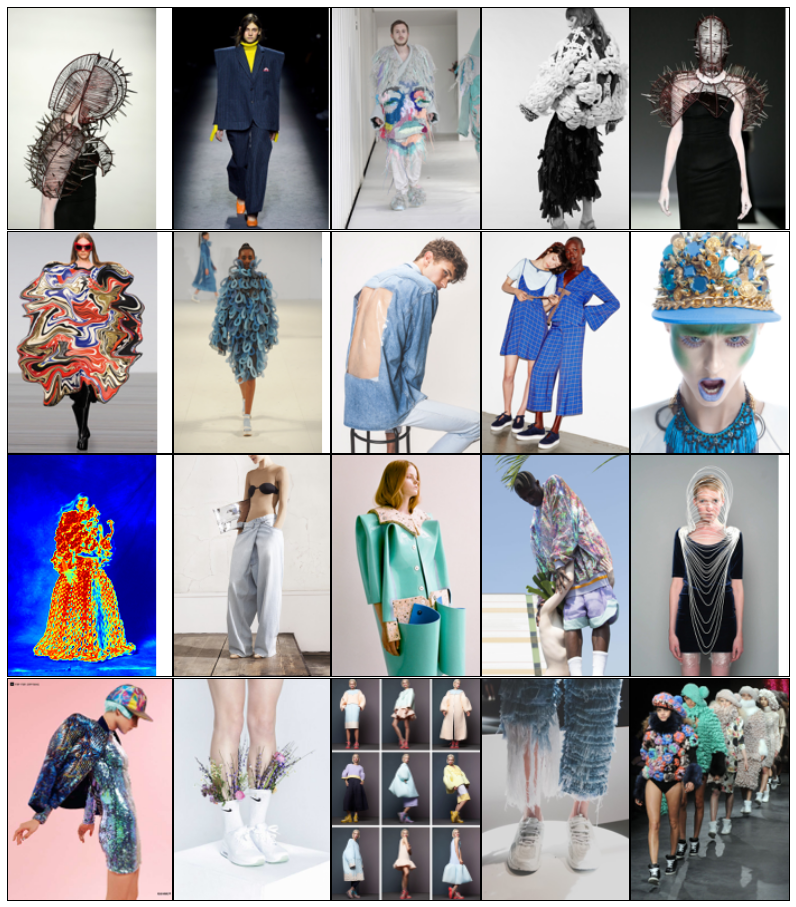

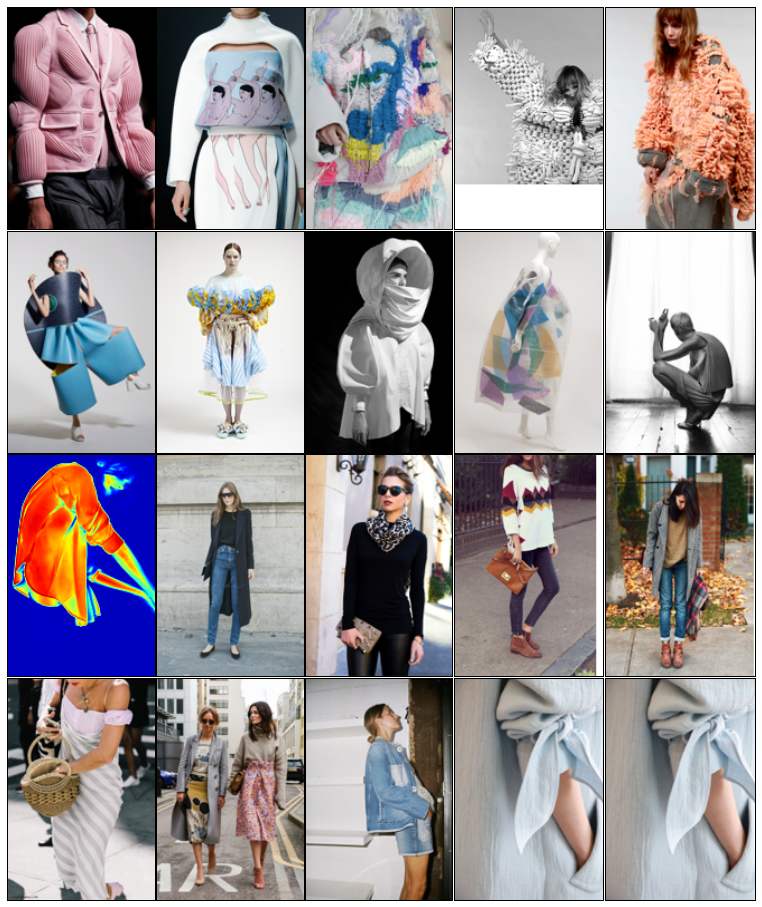

DavidandElla/%E3%83%95%E3%82%A1%E3%83%83%E3%82%B7%E3%83%A7%E3%83%B3


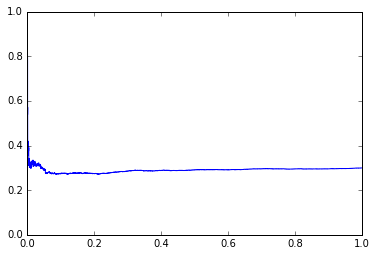

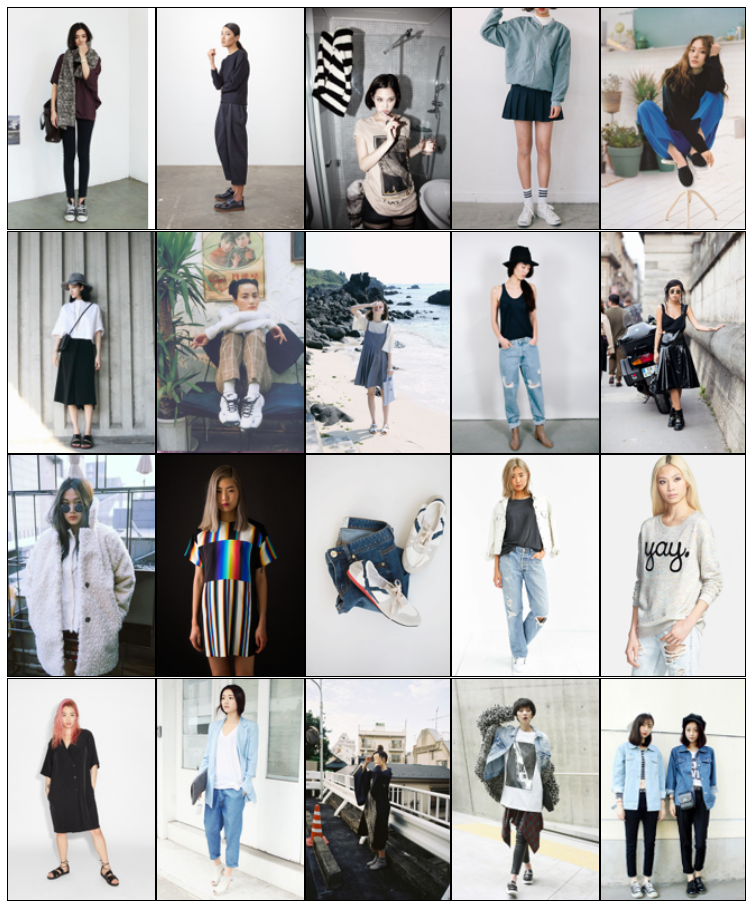

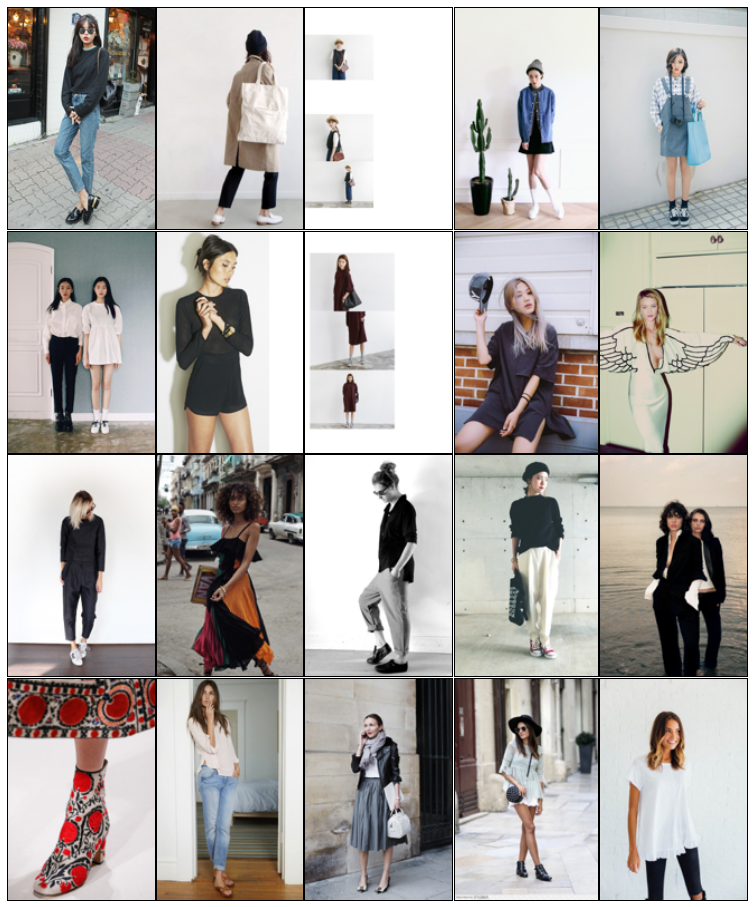

In [20]:
base_dir = '/data/neon/customer_images/image_collections/intl_fashion/'
for group in list(set(fashion_features.ix['ファッション'].index.get_level_values('group')))[:5]:
    print group
    corpus_dists, query_dists = plot_prcurve_for_group(fashion_features, group, min_dist_rank_func)
    show_images(query_dists, base_dir)
    show_images(corpus_dists, base_dir)
    

## Inception Examples
For this analysis, we queried the same collections as above. Unlike above, here we used the Inception features for our feature space to identify similarity, instead of using our valence features.

Note that the Inception features are picking up similarities in clearly defined objects.

In [8]:
inception_fashion_features = pd.read_pickle('/data/neon/customer_images/image_collections/intl_fashion/intl_fashion_inception.pkl')
inception_fashion_features = prep_data(inception_fashion_features)

ellegirl_jp/fashion-news-%E3%83%95%E3%82%A1%E3%83%83%E3%82%B7%E3%83%A7%E3%83%B3%E3%83%8B%E3%83%A5%E3%83%BC%E3%82%B9


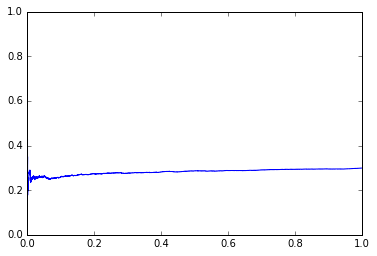

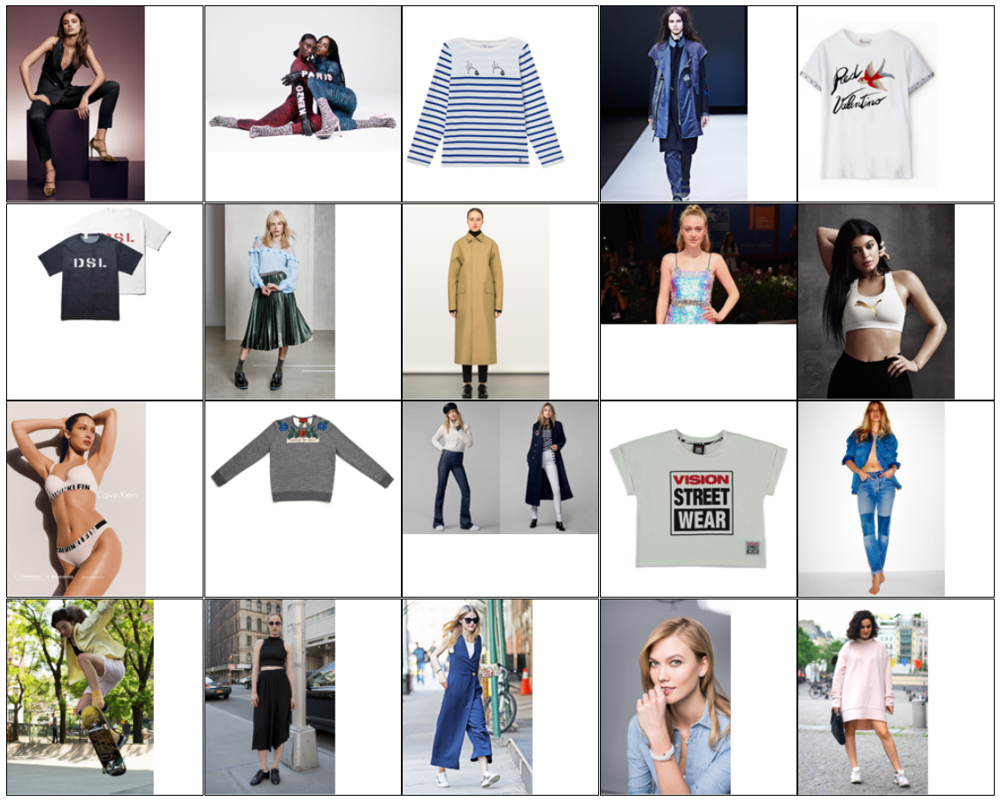

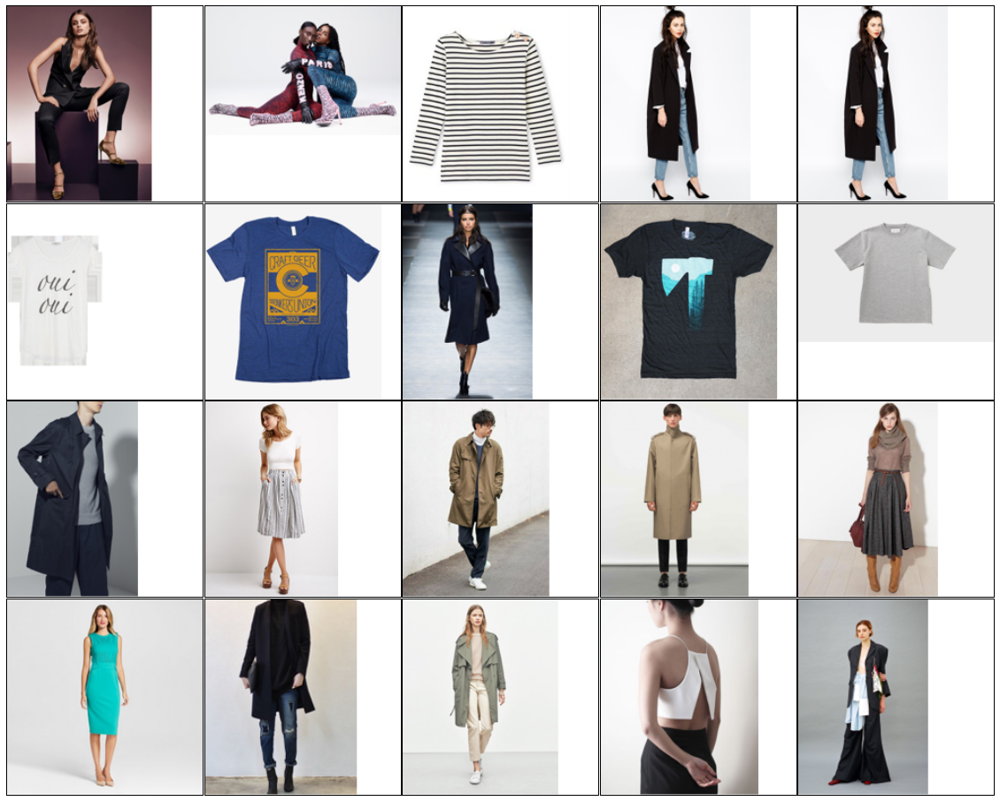

yusuke0101/%E3%83%95%E3%82%A1%E3%83%83%E3%82%B7%E3%83%A7%E3%83%B3


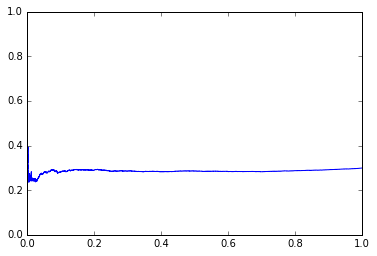

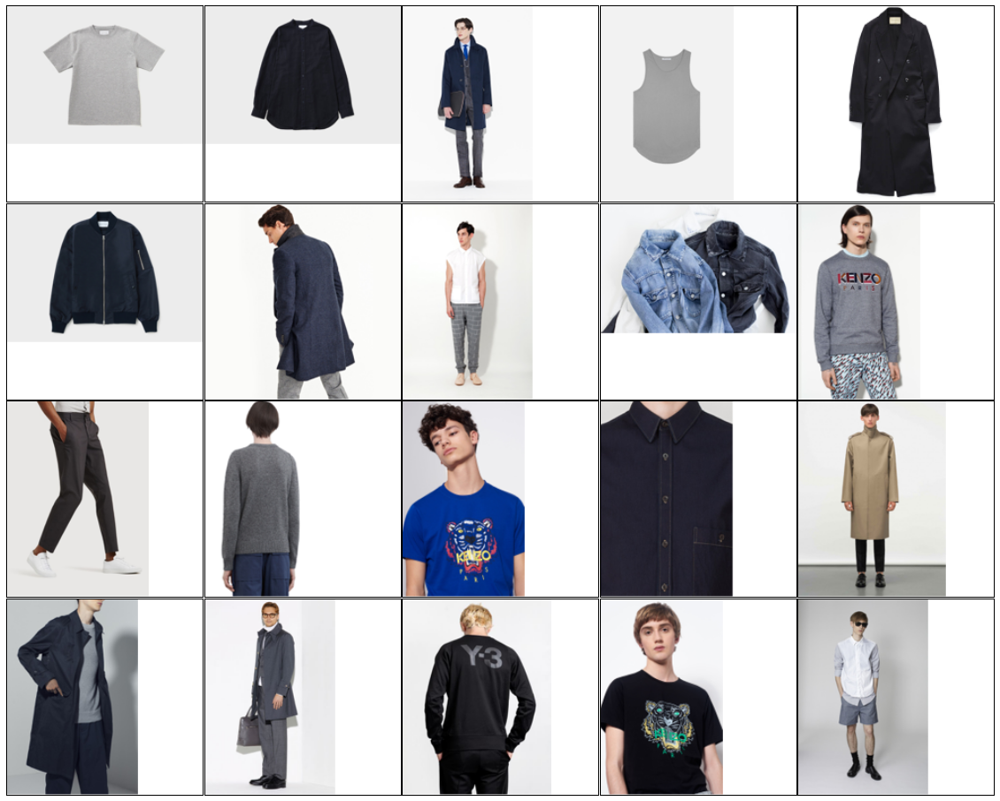

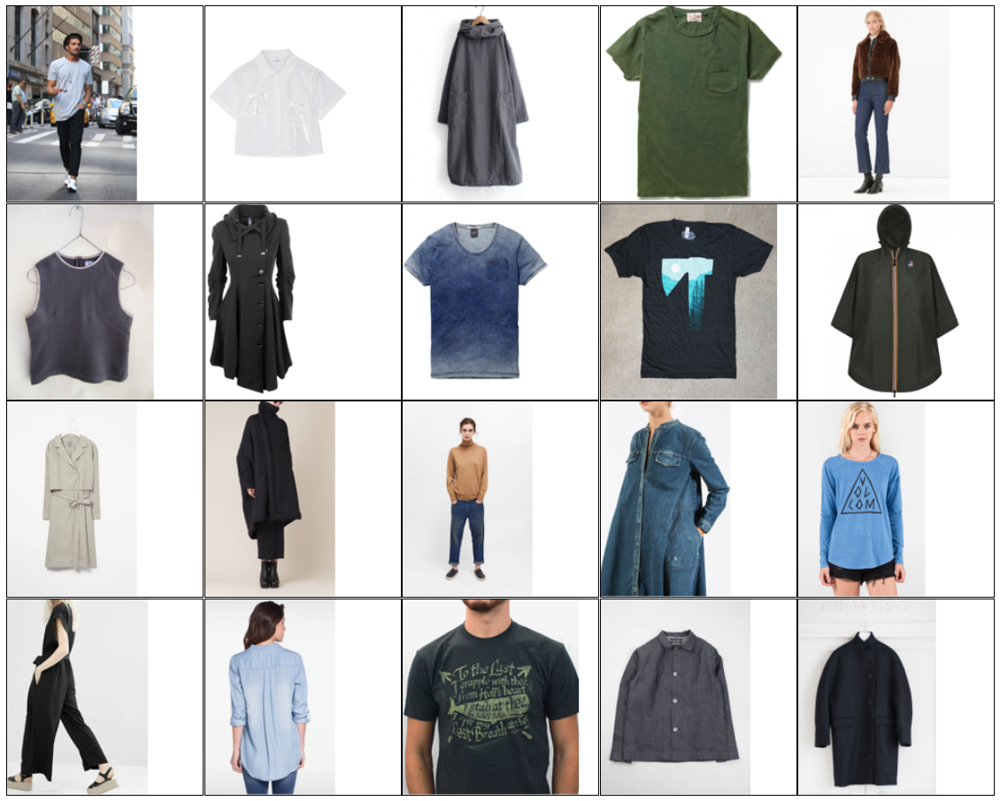

retreatsakura/%E3%83%95%E3%82%A1%E3%83%83%E3%82%B7%E3%83%A7%E3%83%B3


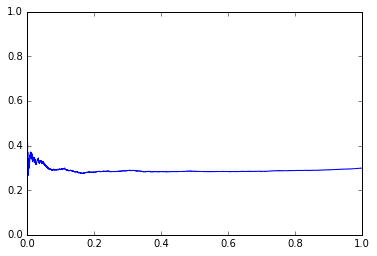

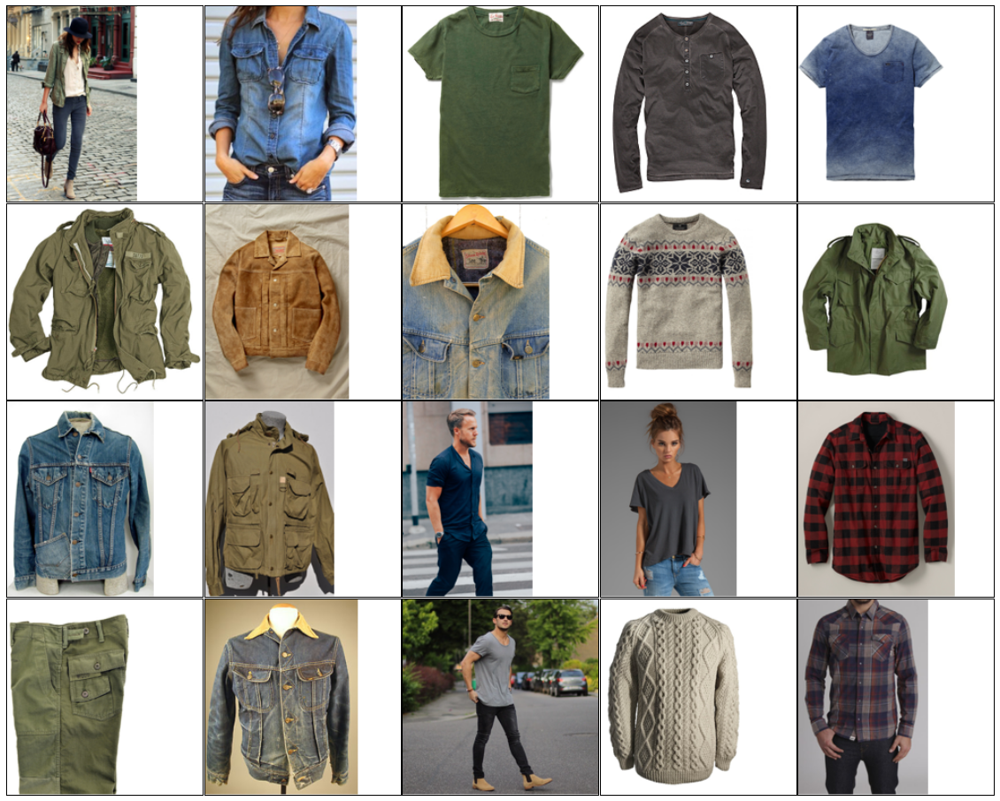

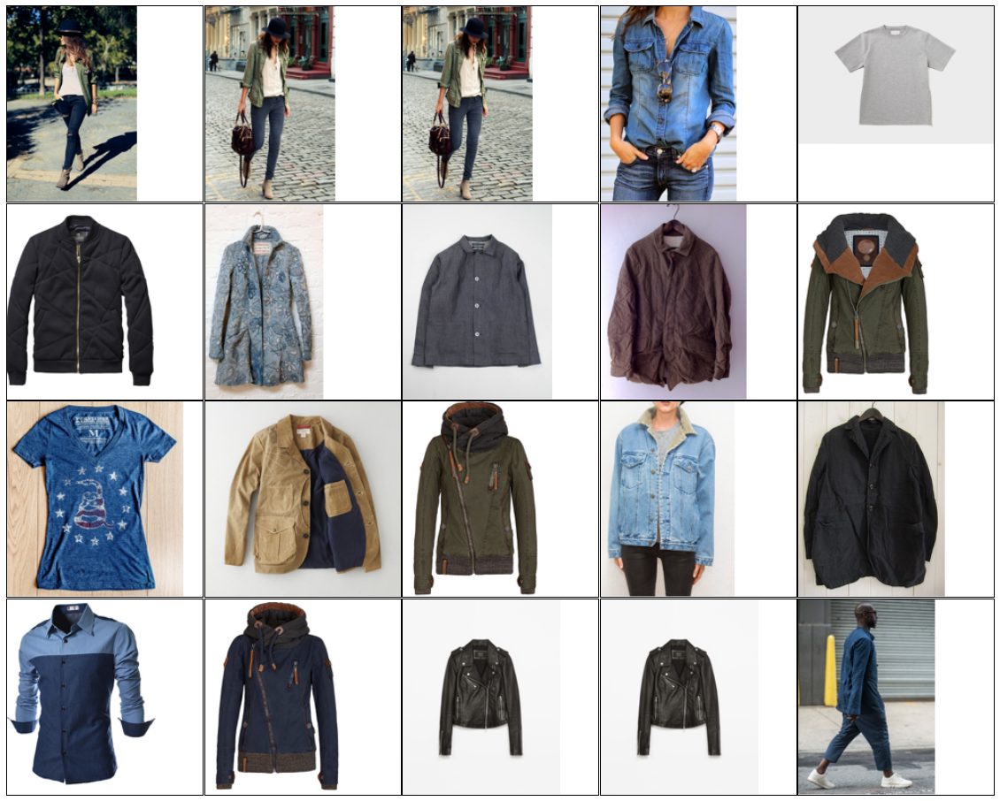

KUNOMARI517/%E3%83%95%E3%82%A1%E3%83%83%E3%82%B7%E3%83%A7%E3%83%B3


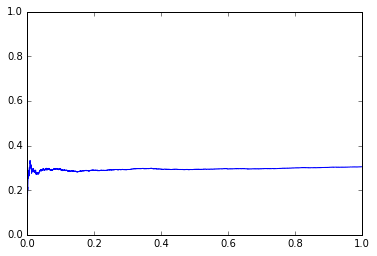

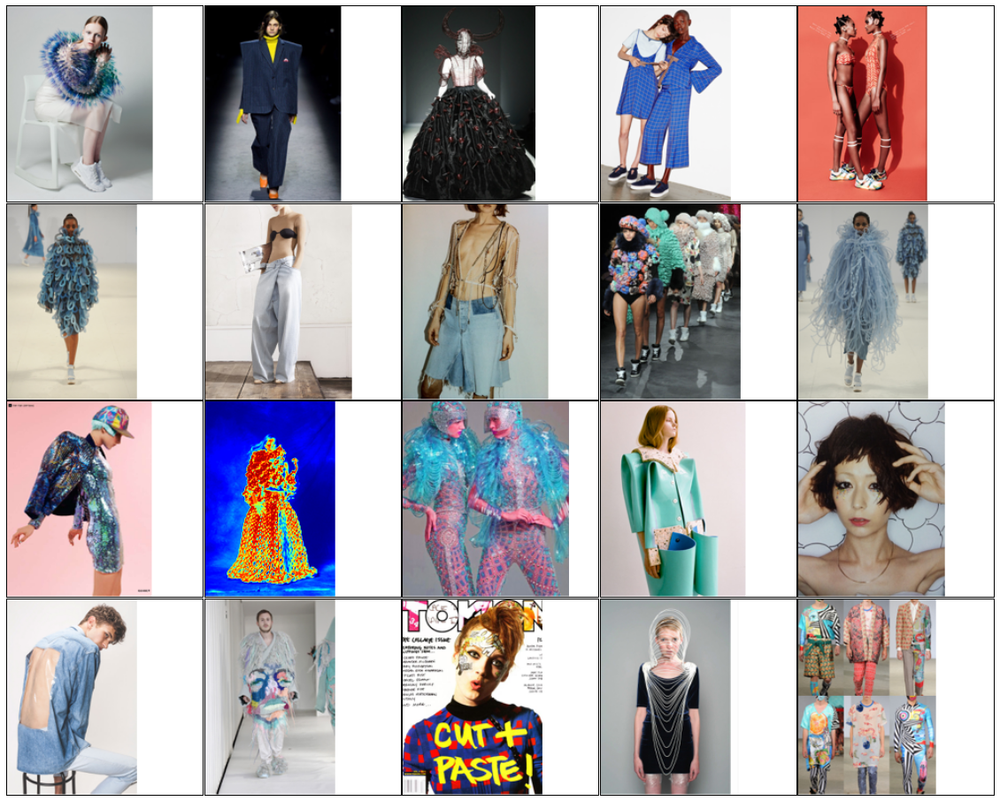

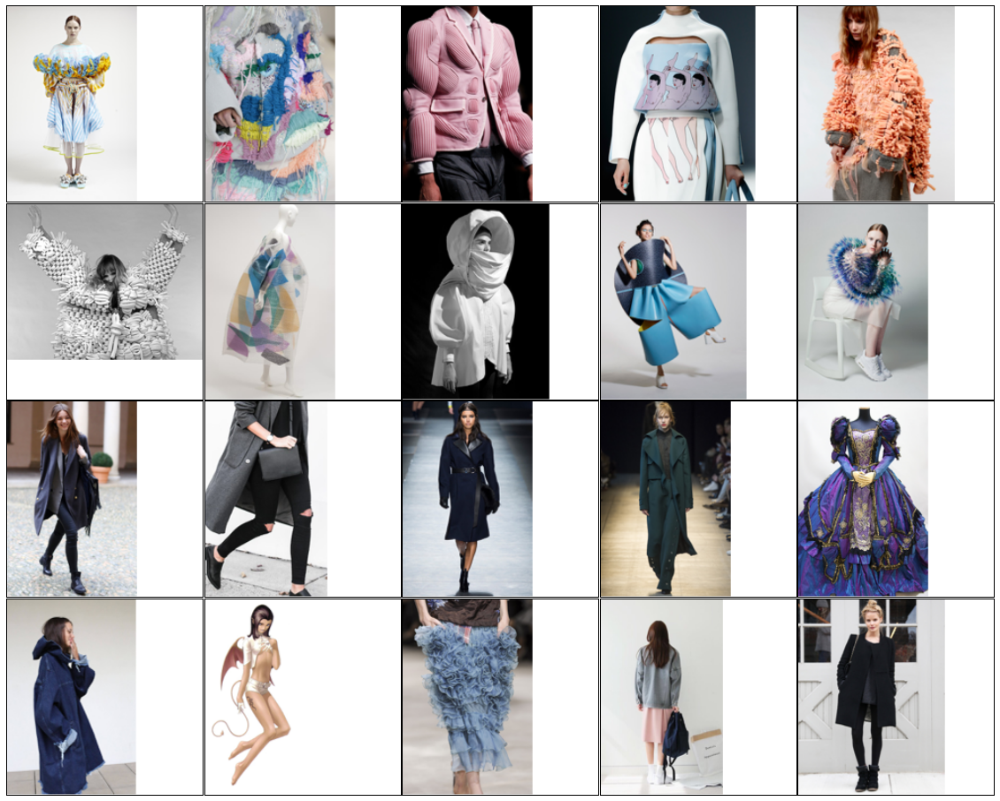

DavidandElla/%E3%83%95%E3%82%A1%E3%83%83%E3%82%B7%E3%83%A7%E3%83%B3


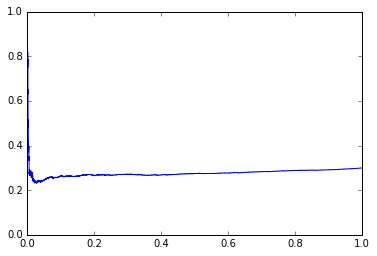

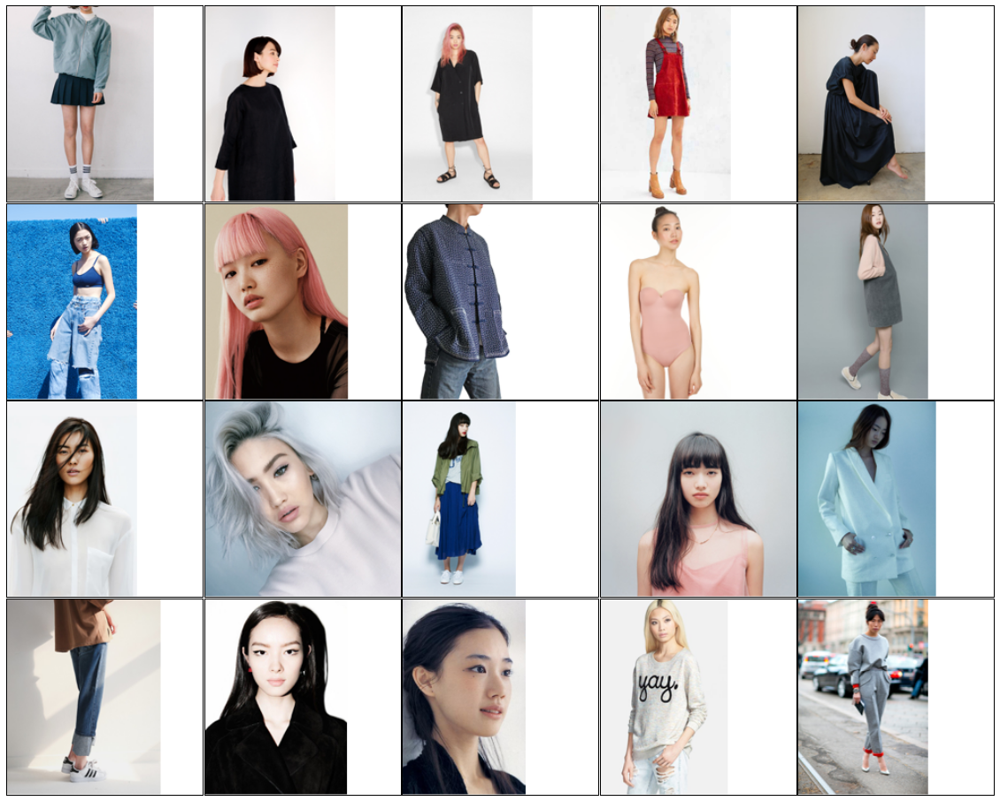

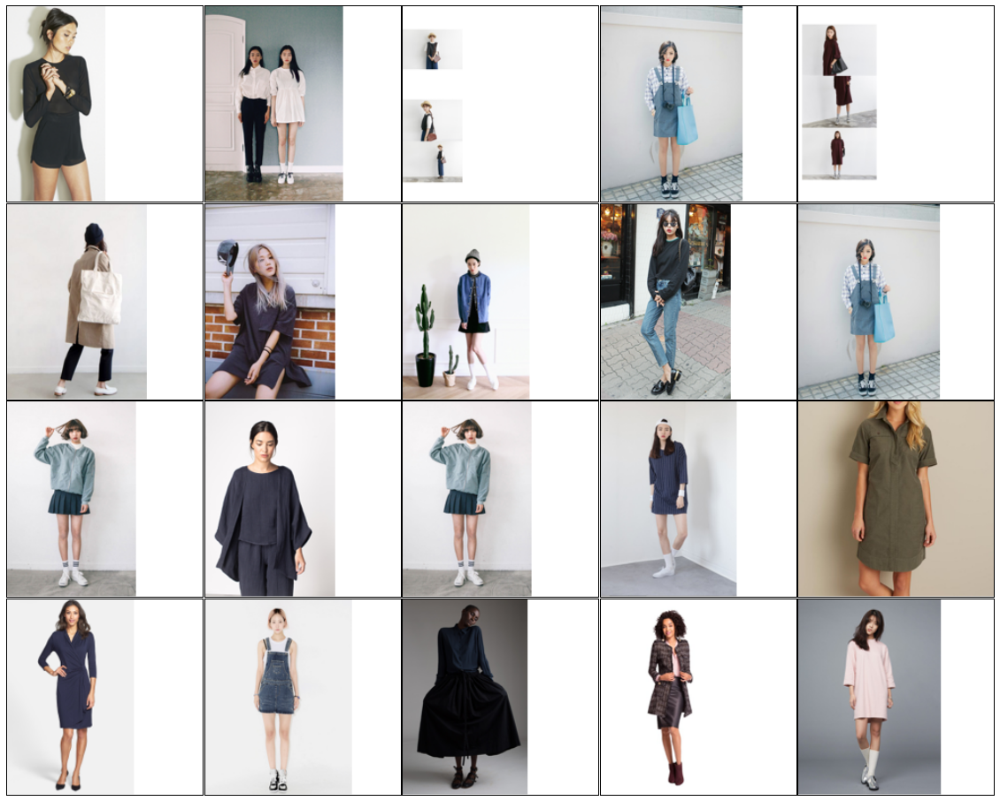

In [9]:
base_dir = '/data/neon/customer_images/image_collections/intl_fashion/'
for group in list(set(inception_fashion_features.ix['ファッション'].index.get_level_values('group')))[:5]:
    print group
    corpus_dists, query_dists = plot_prcurve_for_group(inception_fashion_features, group, min_dist_rank_func)
    show_images(query_dists, base_dir)
    show_images(corpus_dists, base_dir)